# Description:
This script focusses on the transit curve (Average $V_{RMS}$ as a function of LST), comparing the transit curve for different stations at the same time and investigation of the timetraces associated to the peaks and valleys found in these transit curves. Here we see that at the peaks, the zero averaging of the timetraces malfunctions.

# Import modules:

In [1]:
import numpy as np
import scipy as sc
import scipy.fft as scfft
import matplotlib.pyplot as plt
import uproot
import os
import time
#%matplotlib widget
#%matplotlib notebook

In [2]:
%%capture out
%run /mnt/c/Users/Jethro/Desktop/Master\ Thesis/Functions.ipynb
%run /mnt/c/Users/Jethro/Desktop/RNO-G/GalaxyFunctions.ipynb

# The transit curve itself:

In [3]:
RunList=np.concatenate((np.arange(8,24),np.arange(306,310),np.arange(289,298),np.arange(284,288),np.arange(162,186)))
print(RunList)

[  8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23 306 307
 308 309 289 290 291 292 293 294 295 296 297 284 285 286 287 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185]


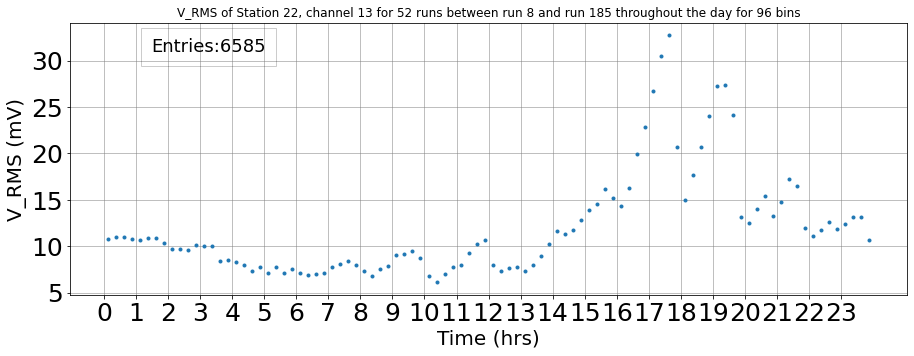

In [4]:
DailyVoltAvg(22,13,RunList,NBins=4*24,ZeroAvg=False)

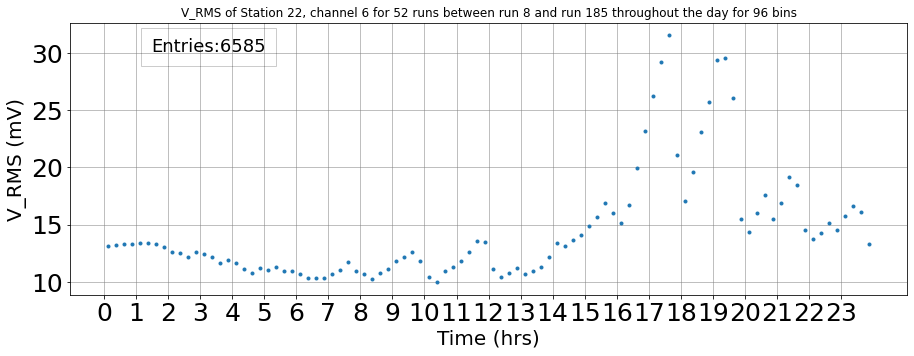

In [5]:
DailyVoltAvg(22,6,RunList,NBins=4*24,ZeroAvg=False)

# Comparing the transit curve for different stations at the same time:

Proofs of concept:

In [6]:
#Test=np.concatenate((np.array([[1,2,3,4]]),np.array([[5,6,7,8]])),axis=0)
Test = np.empty((0,4),float)
print(Test)

Test=np.concatenate((Test,np.array([[9,10,11,12]])),axis=0)
print(Test)
Test=np.concatenate((Test,np.array([[1,2,3,4]]),np.array([[5,6,7,8]])),axis=0)
print(Test)

print(Test[0])
print(Test[0][1])

[]
[[ 9. 10. 11. 12.]]
[[ 9. 10. 11. 12.]
 [ 1.  2.  3.  4.]
 [ 5.  6.  7.  8.]]
[ 9. 10. 11. 12.]
10.0


In [7]:
#Test=np.concatenate((np.array([[1,2,3,4]]),np.array([[5,6,7,8]])),axis=0)
Test = np.empty((4,0),float)
print(Test)

Test=np.concatenate((Test,np.array([[9],[10],[11],[12]])),axis=1)
print(Test)
Test=np.concatenate((Test,np.array([[i] for i in range(4)]),np.array([[5],[6],[7],[8]]),np.array([[i] for i in range(13,17)])),axis=1)
print(Test)

print(Test[0])
print(Test[0][1])

[]
[[ 9.]
 [10.]
 [11.]
 [12.]]
[[ 9.  0.  5. 13.]
 [10.  1.  6. 14.]
 [11.  2.  7. 15.]
 [12.  3.  8. 16.]]
[ 9.  0.  5. 13.]
0.0


Met deze manier van concatenaten hebben we de volgende indexering Test[ChNr][TimeBin]

In [8]:
for i in np.arange(4):
    xidx=i%2
    if i <2:
        yidx=0
    else:
        yidx=1
    print((xidx,yidx))

(0, 0)
(1, 0)
(0, 1)
(1, 1)


In [8]:
from datetime import datetime
print(datetime.utcfromtimestamp(RunStartTime(22, 20)))
print(datetime.utcfromtimestamp(RunEndTime(22, 20)))

2021-07-18 15:19:07.244034
2021-07-18 17:17:27.952476


In [11]:
RunListBorders=[[8,24],[306,310],[290,298],[284,285],[162,186]] #Paar waarden moeten aanpassen wegens afwezigheid run files
RunListTimes=[[RunStartTime(22, RunListBorders[i][0]),RunStartTime(22, RunListBorders[i][1])] for i in np.arange(len(RunListBorders))]

In [13]:
TimedRunList(22,11,RunsRange=[162,186])

array([134., 135., 136., 137., 138., 139., 140., 141., 142., 143., 144.,
       145.])

Comparing this to the run summary from DESY shows that this implementation works. <br>
Now we just need to compute the equivalent run lists for the other stations.

**Station 11:**

In [14]:
RunListSt11=np.array([])
for Runs in RunListBorders:
    RunListSt11=np.append(RunListSt11,TimedRunList(22,11,RunsRange=Runs))
print(RunListSt11)

[268. 252. 253. 254. 255. 256. 257. 258. 245. 134. 135. 136. 137. 138.
 139. 140. 141. 142. 143. 144. 145.]


**Station 21:**

In [15]:
RunListSt21=np.array([])
for Runs in RunListBorders:
    RunListSt21=np.append(RunListSt21,TimedRunList(22,21,RunsRange=Runs))
print(RunListSt21)

[ 48.  49.  50.  51.  52.  53.  54.  55.  56.  57.  58.  62.  63.  64.
  65.  66.  67. 428. 429. 430. 431. 420. 421. 422. 423. 424. 425. 426.
 398. 245. 246. 247. 248. 249. 250. 251. 252. 253. 254. 255. 256. 257.
 258. 259. 260. 261. 262. 263. 264. 265. 266. 267. 268. 269.]


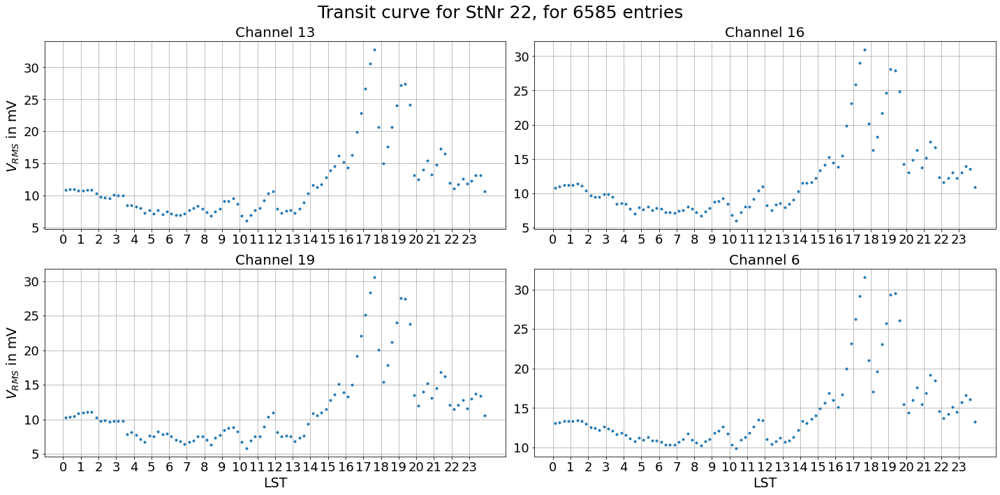

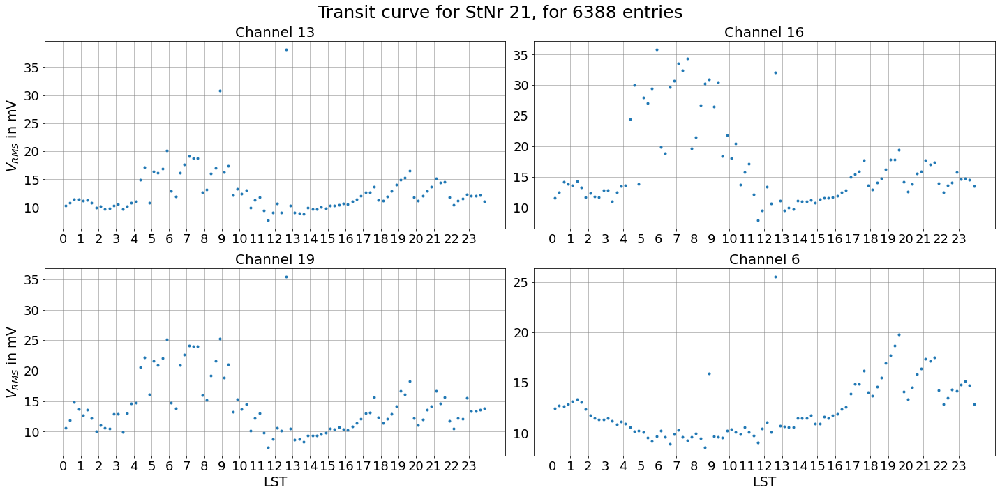

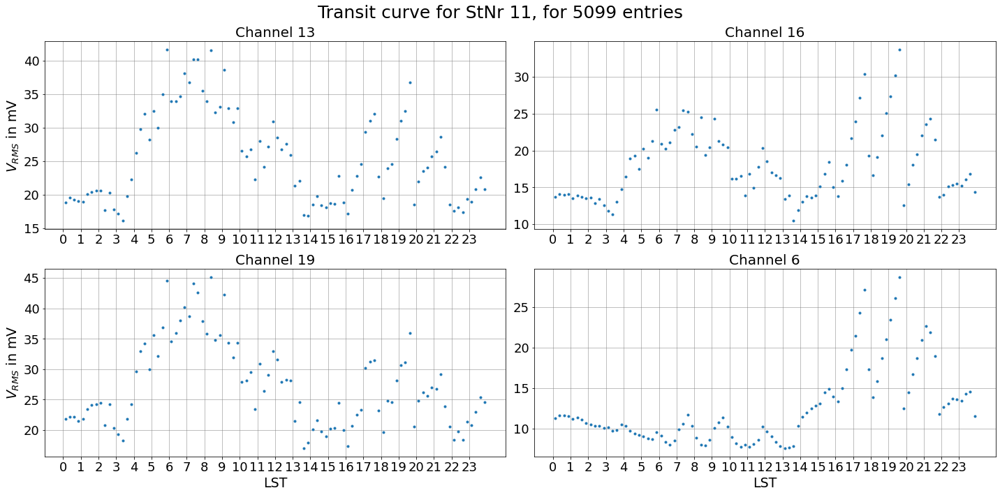

In [16]:
TransitCurves(22,6,RunList,NBins=4*24,ZeroAvg=False)
TransitCurves(21,6,[int(Run) for Run in RunListSt21],NBins=4*24,ZeroAvg=False)
TransitCurves(11,6,[int(Run) for Run in RunListSt11],NBins=4*24,ZeroAvg=False)

And so the structure to the right still seems to be intact even at other stations at this time, however, for earlier LST the curve is blown up at the upwards facing LPDA's of the other stations.

# Investigating the timetraces of peak and valley points in the transit curve:

In [18]:
St22RPeakRuns, St22RPeakEvents=RunsInTimeframe(22,17.5,17.75,Runs=RunList)
St22RValleyRuns, St22RValleyEvents=RunsInTimeframe(22,18.,18.25,Runs=RunList)

In [20]:
print(St22RPeakRuns)
St22RPeakEvents

[162. 163. 174.]


[[646, 656, 669, 672, 674, 689, 699, 716],
 [1],
 [604, 609, 618, 619, 622, 641, 651, 658, 660, 665, 686]]

**For the peak on the right side (LST=17.5->17.75), which has a $V_{RMS}$ of about 34mV:**

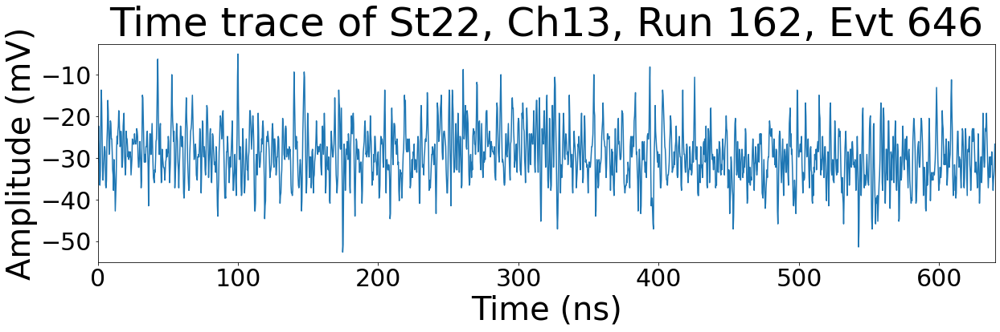

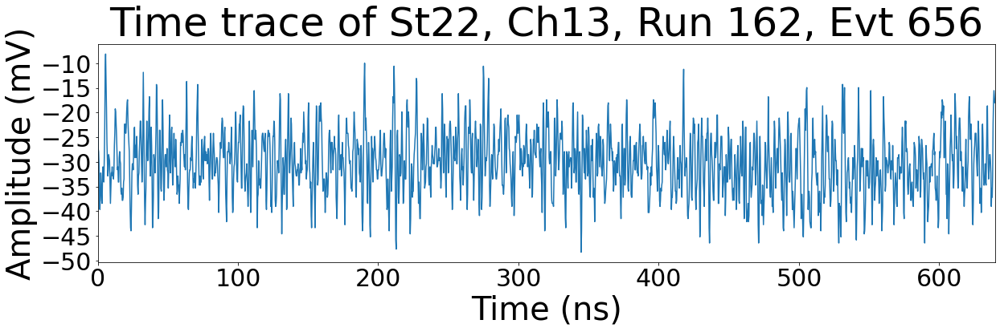

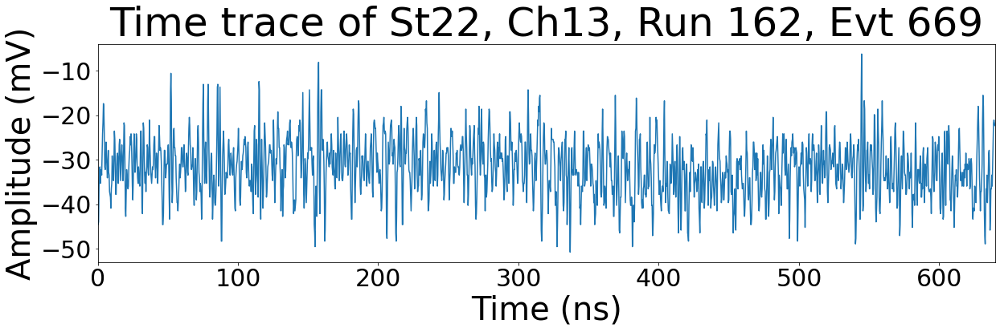

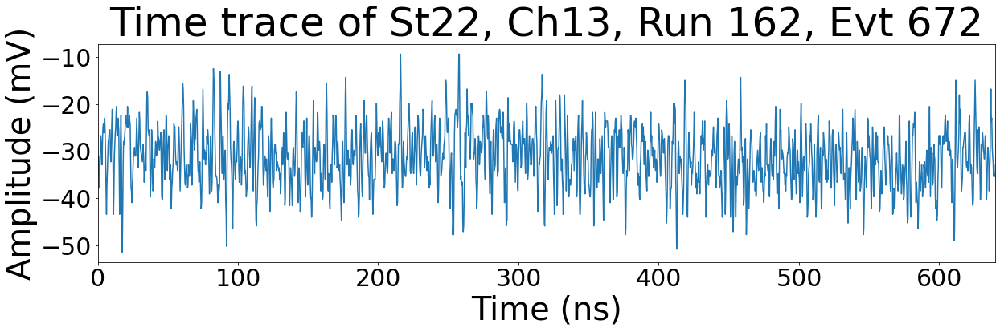

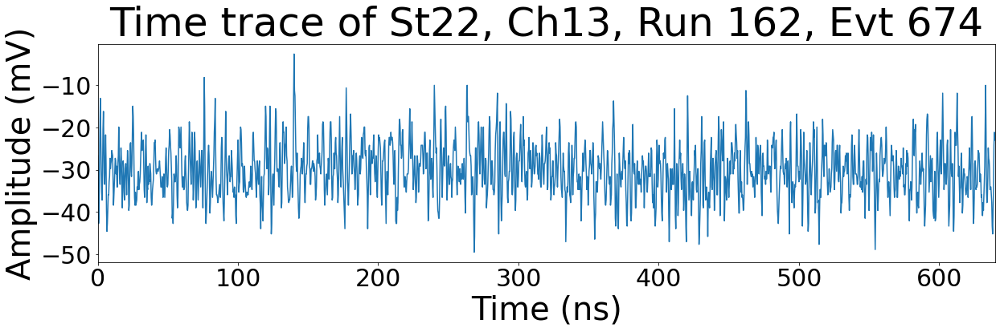

...

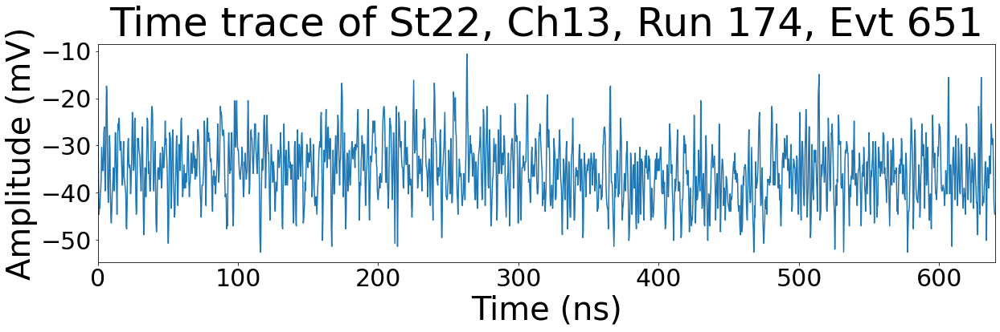

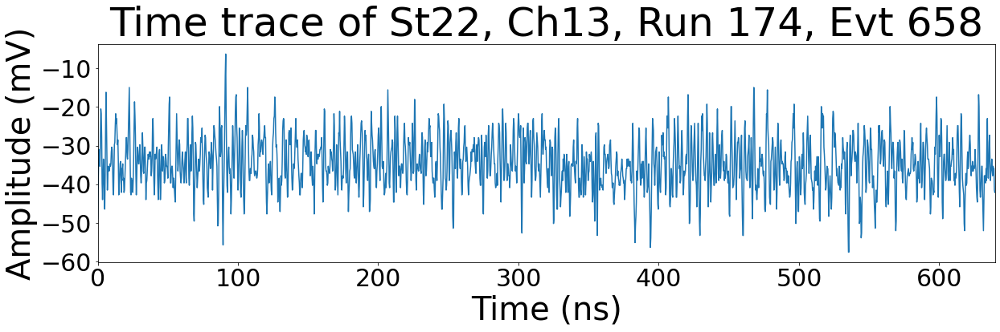

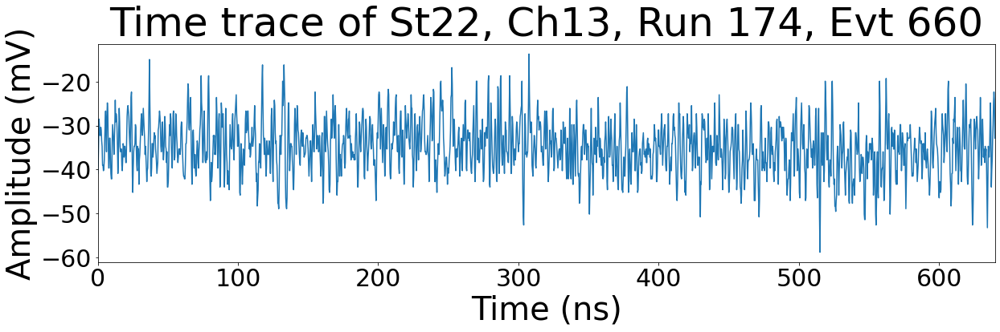

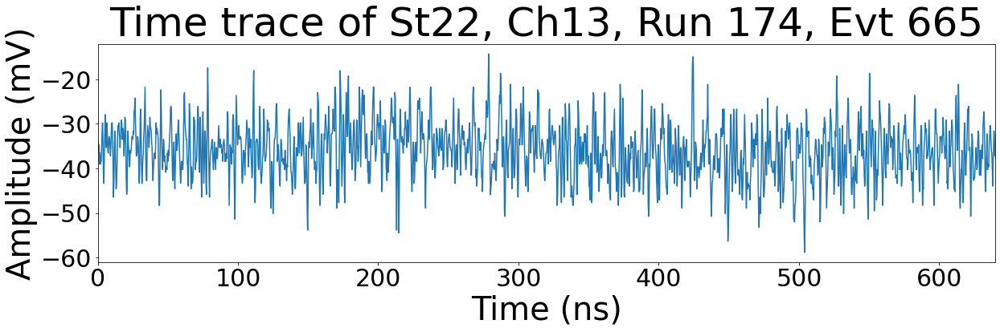

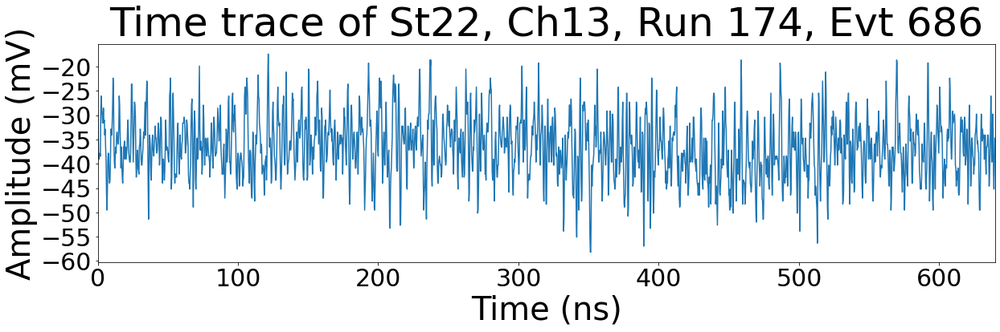

In [21]:
for RunIdx in range(len(St22RPeakRuns)):
    for EvtIdx in range(len(St22RPeakEvents[RunIdx])):
        #print(RunIdx,EvtIdx,St22RPeakRuns[RunIdx],St22RPeakEvents[RunIdx][EvtIdx])
        TimeTrace(22,13,int(St22RPeakRuns[RunIdx]),St22RPeakEvents[RunIdx][EvtIdx],Amplitude="mV")

**For the valley on the right side (LST=18->18.25), which has a $V_{RMS}$ of about 15mV:**

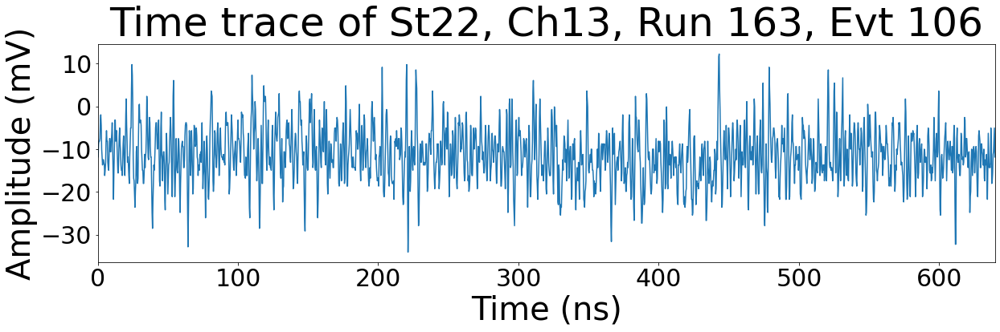

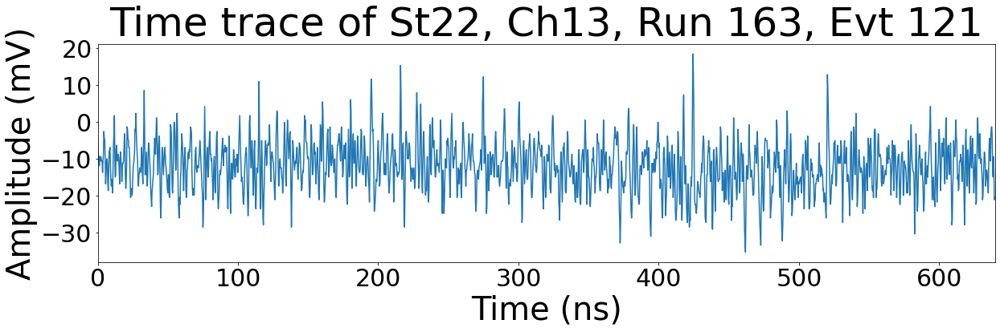

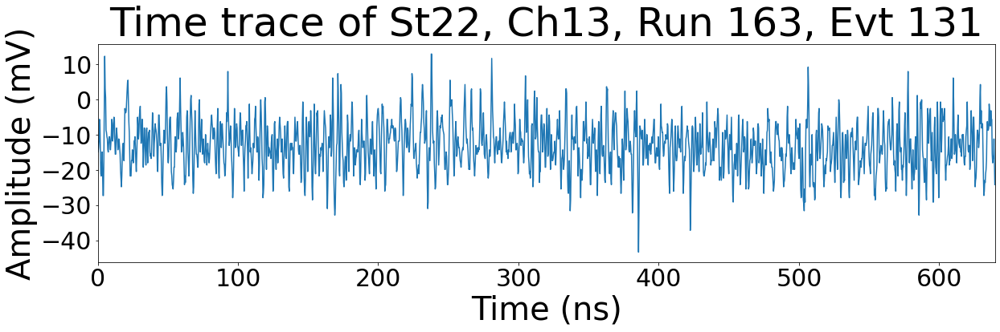

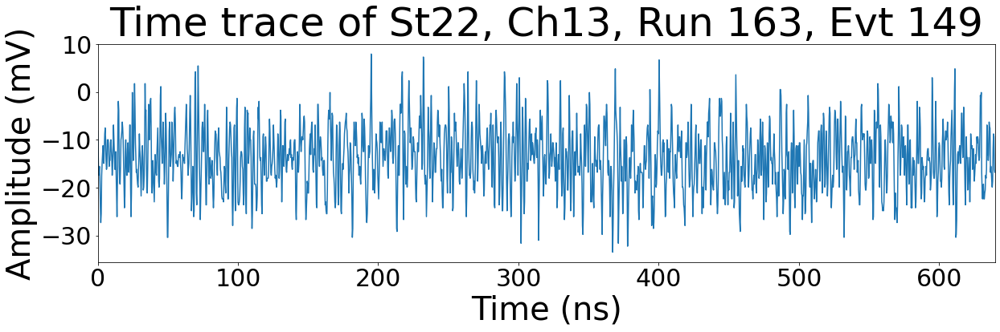

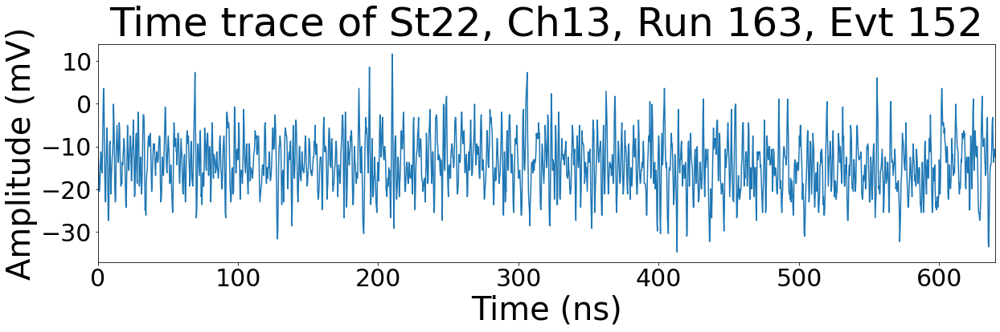

...

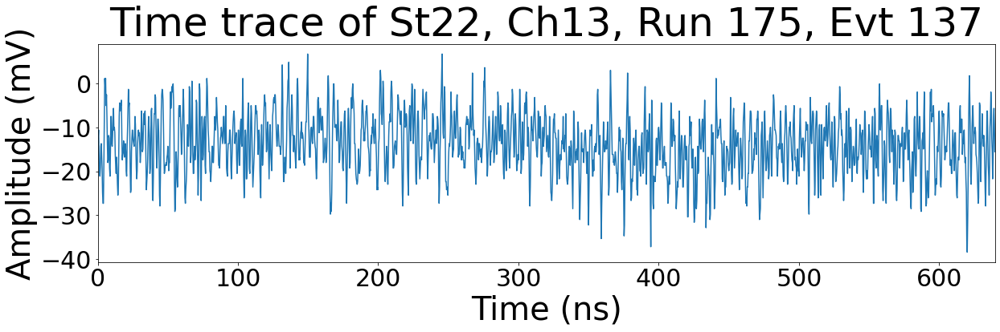

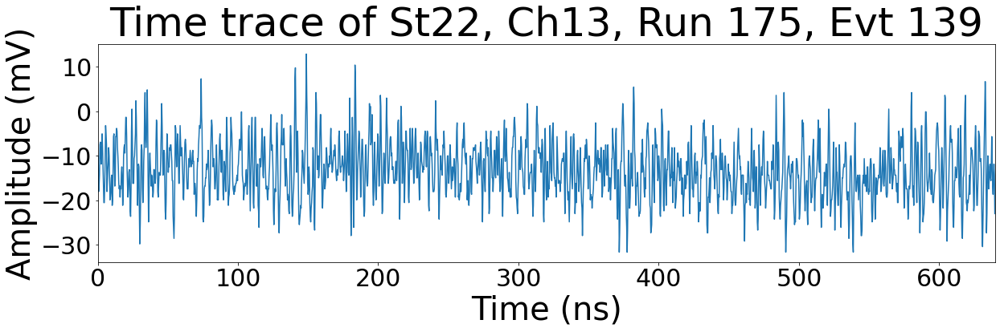

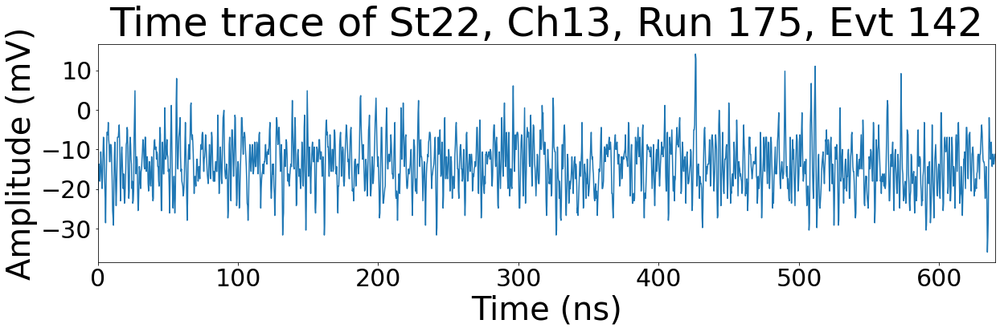

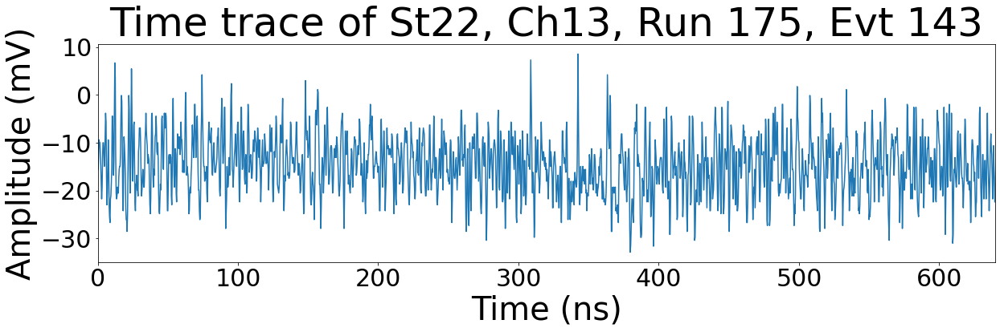

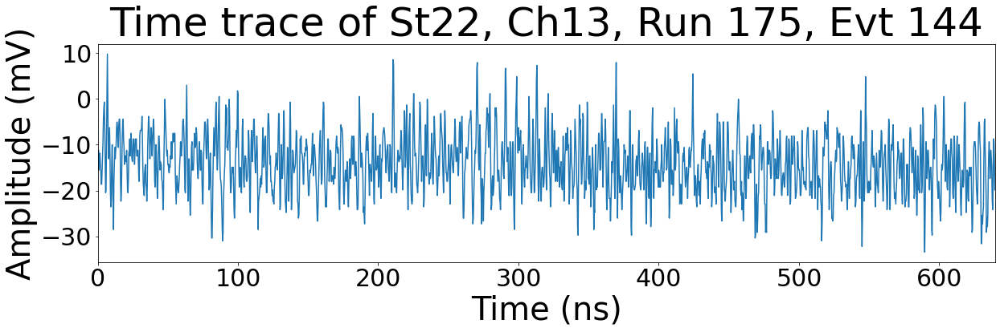

In [22]:
for RunIdx in range(len(St22RValleyRuns)):
    for EvtIdx in range(len(St22RValleyEvents[RunIdx])):
        #print(RunIdx,EvtIdx,St22RPeakRuns[RunIdx],St22RPeakEvents[RunIdx][EvtIdx])
        TimeTrace(22,13,int(St22RValleyRuns[RunIdx]),St22RValleyEvents[RunIdx][EvtIdx],Amplitude="mV")

In [23]:
St22LPeakRuns, St22LPeakEvents=RunsInTimeframe(22,11.75,12.,Runs=RunList)
St22LValleyRuns, St22LValleyEvents=RunsInTimeframe(22,10.25,10.5,Runs=RunList)

**For the peak on the left side (LST=11.75->12), which has a $V_{RMS}$ of about 11mV:**

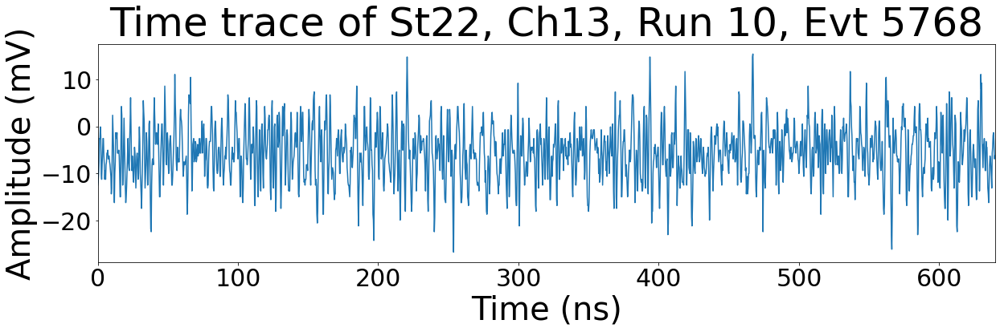

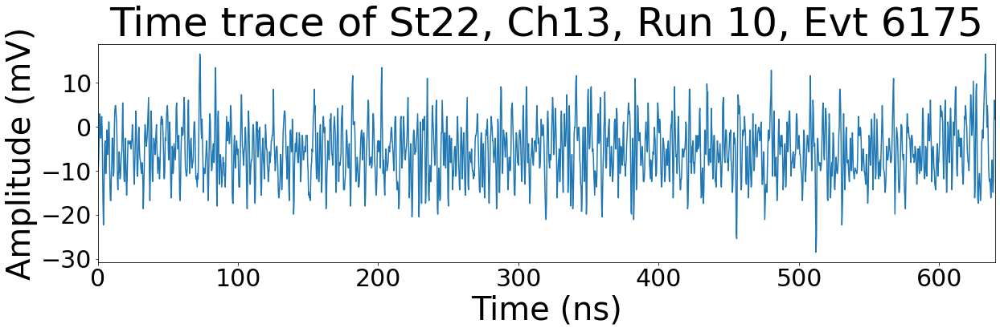

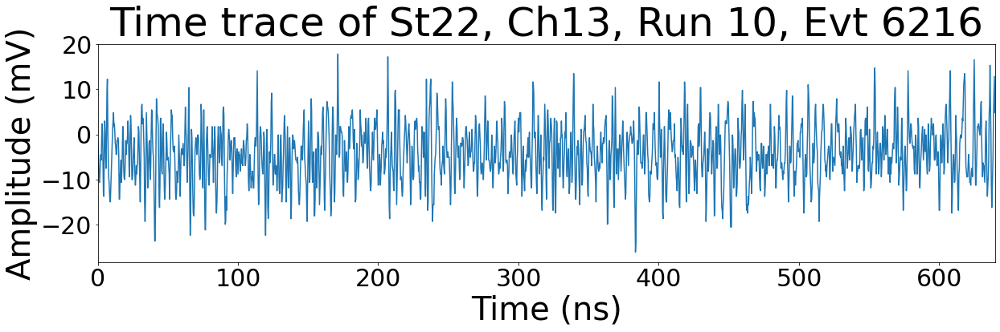

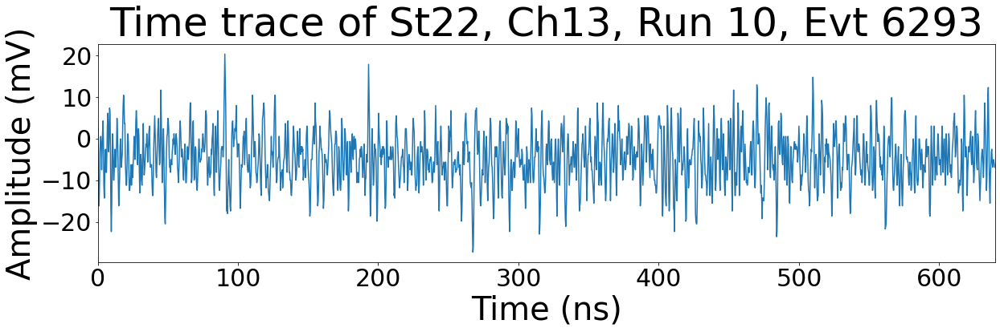

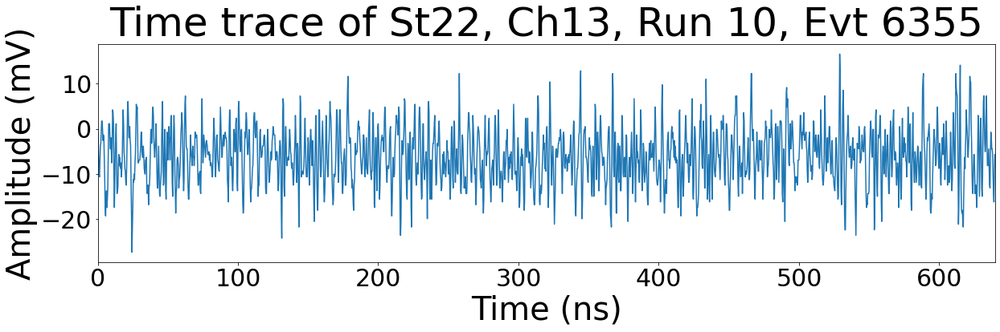

...

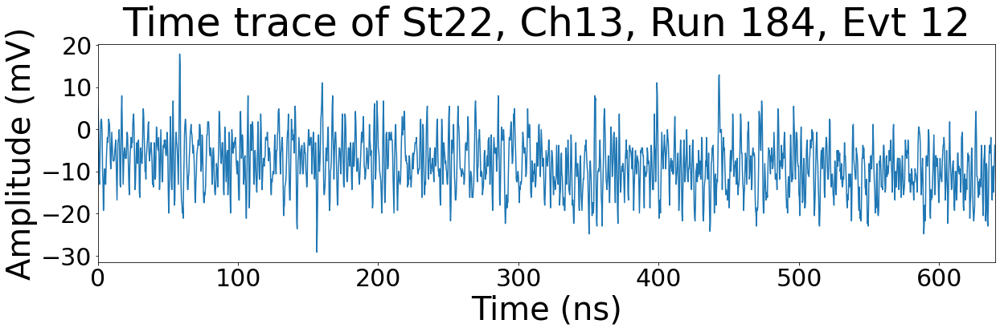

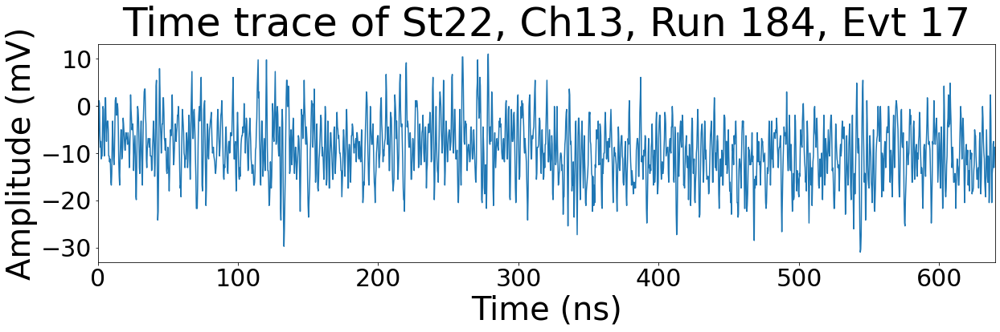

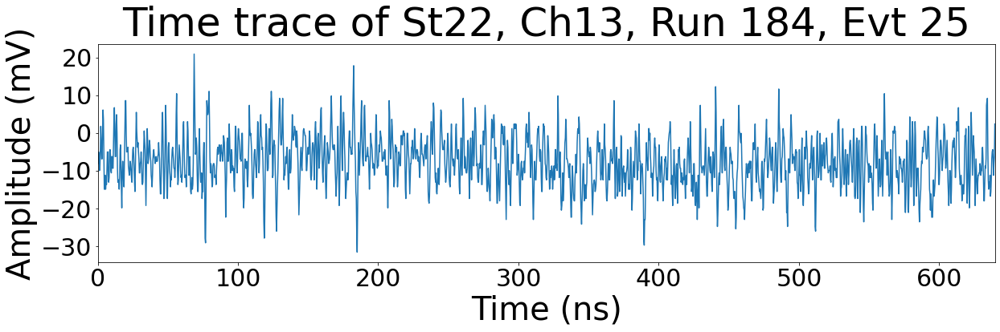

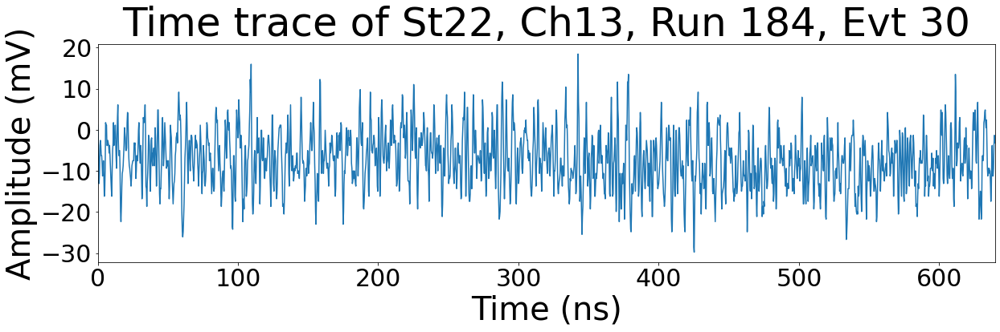

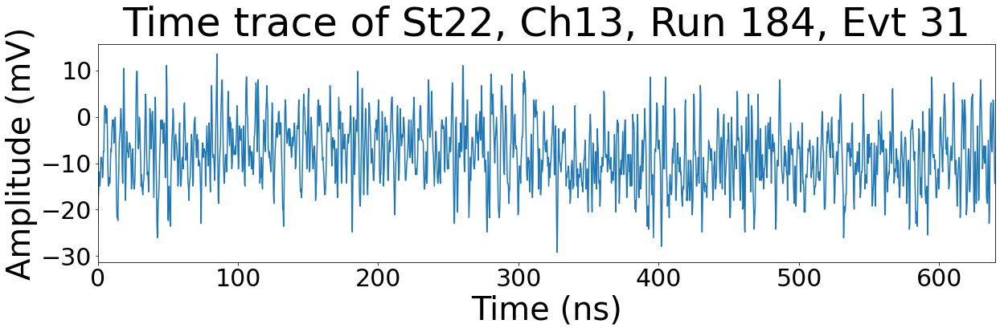

In [24]:
for RunIdx in range(len(St22LPeakRuns)):
    for EvtIdx in range(len(St22LPeakEvents[RunIdx])):
        #print(RunIdx,EvtIdx,St22RPeakRuns[RunIdx],St22RPeakEvents[RunIdx][EvtIdx])
        TimeTrace(22,13,int(St22LPeakRuns[RunIdx]),St22LPeakEvents[RunIdx][EvtIdx],Amplitude="mV")

**For the valley on the left side (LST=10.25->10.5), which has a $V_{RMS}$ of about 7mV:**

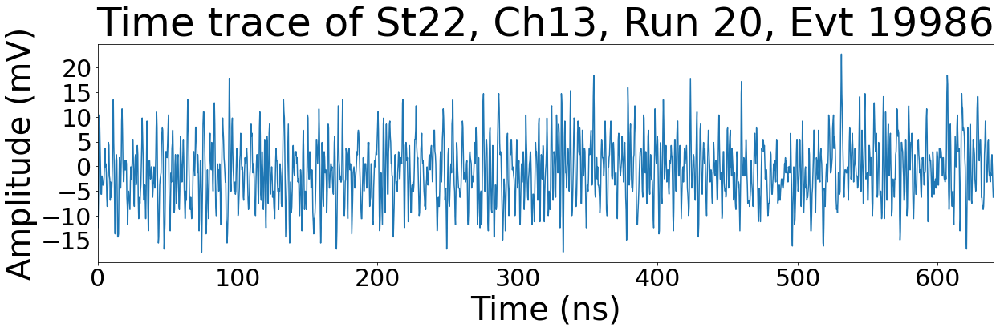

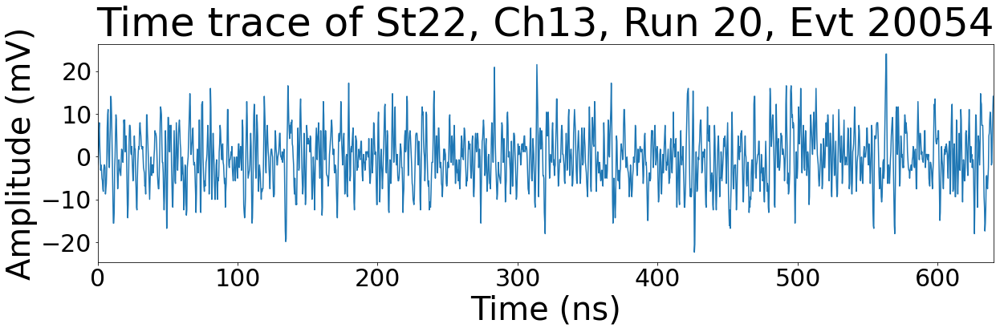

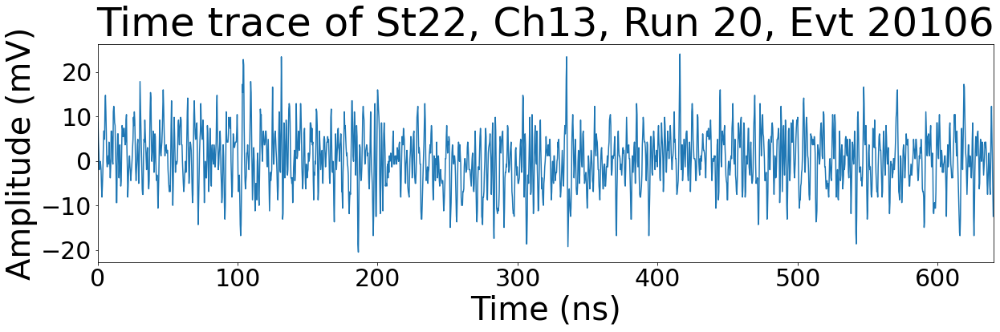

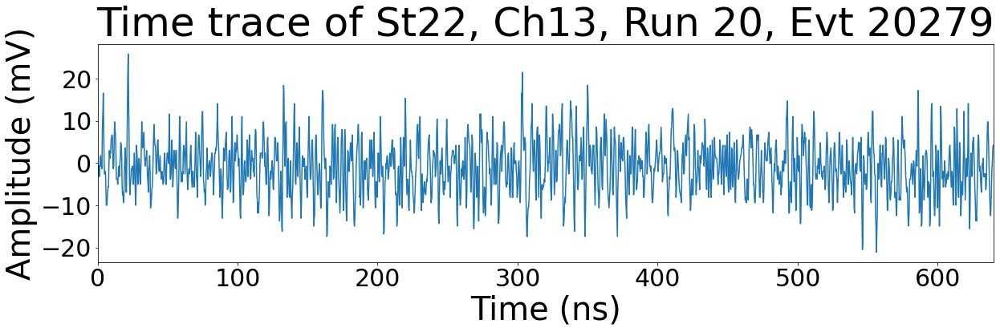

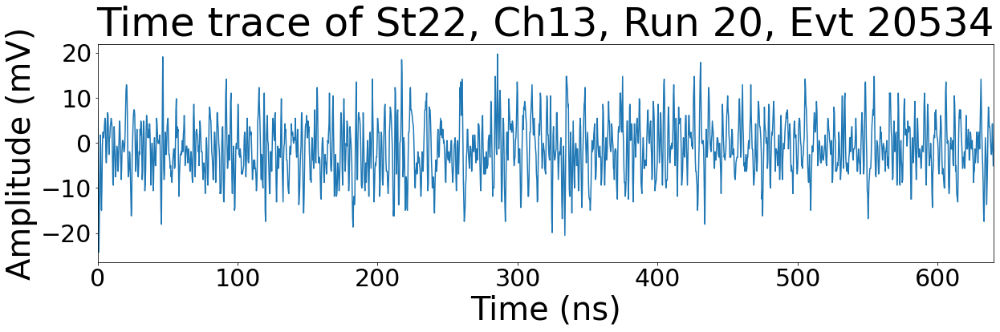

...

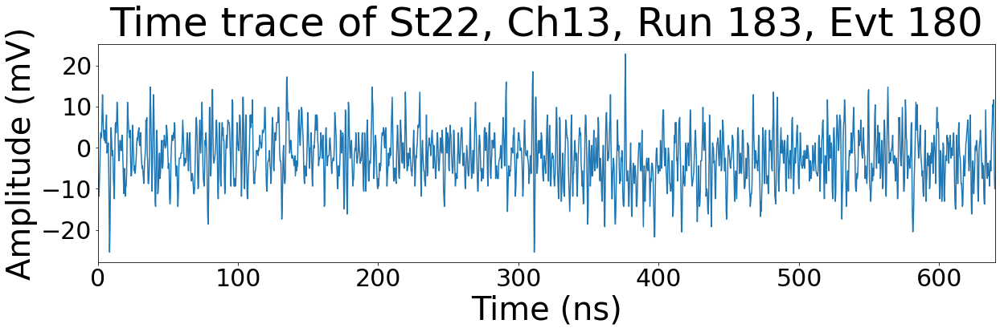

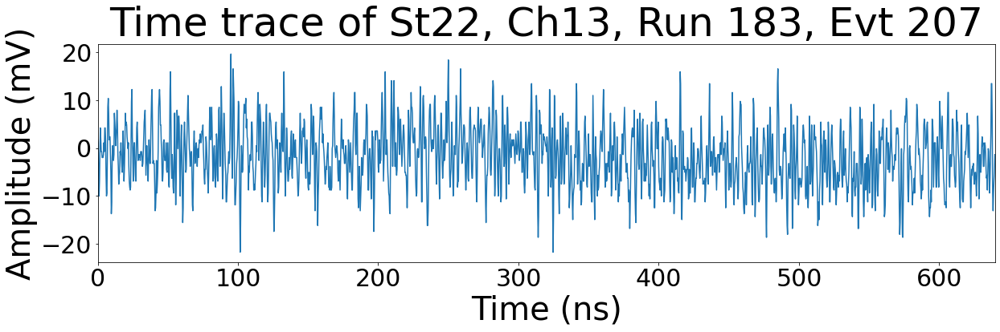

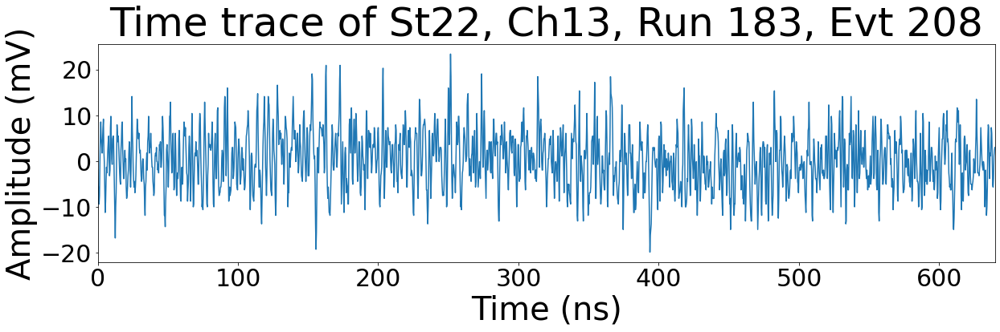

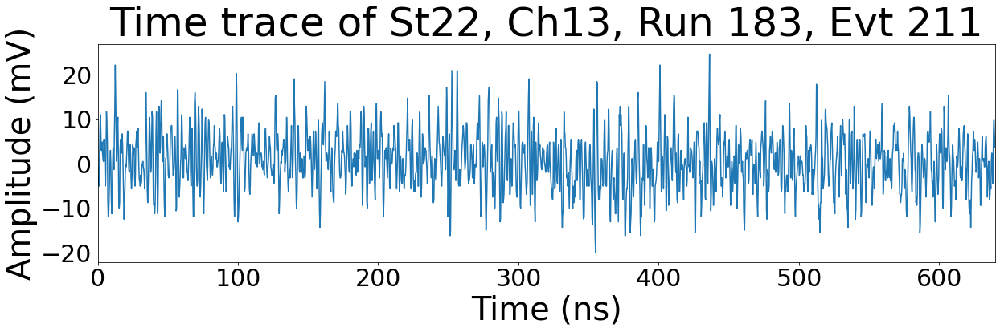

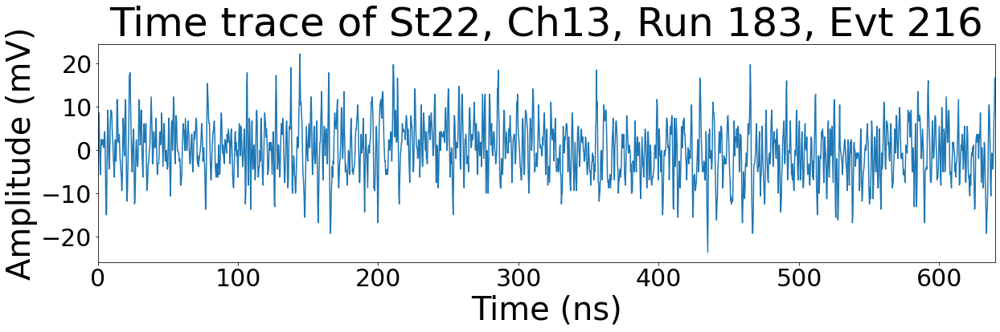

In [25]:
for RunIdx in range(len(St22LValleyRuns)):
    for EvtIdx in range(len(St22LValleyEvents[RunIdx])):
        #print(RunIdx,EvtIdx,St22RPeakRuns[RunIdx],St22RPeakEvents[RunIdx][EvtIdx])
        TimeTrace(22,13,int(St22LValleyRuns[RunIdx]),St22LValleyEvents[RunIdx][EvtIdx],Amplitude="mV")

The timetraces from before show us that the average value of the timetrace periodically increase over time, resulting in the peaks as seen in the transit curves. $\Rightarrow$ zero average the timetraces manually and then compute the transit curves: 